In [7]:
len(word_map)

325937

In [8]:
data
# return {'document_id': index, 'sentences': sentences, 'vectors': None, 'tf_idf': None, 'tokens': tokens}

{'0': {'document_id': 0,
  'sentences': [['since',
    '2007',
    'rbas',
    'outstanding',
    'reputation',
    'affected',
    'securency',
    'npa',
    'scandal',
    'rba',
    'subsidiary',
    'involved',
    'bribing',
    'overseas',
    'official',
    'australia',
    'might',
    'win',
    'lucrative',
    'noteprinting',
    'contract',
    'asset',
    'bank',
    'include',
    'gold',
    'foreign',
    'exchange',
    'reserve',
    'australia',
    'estimated',
    'net',
    'worth',
    'a101',
    'billion',
    'nearly',
    '94',
    'rbas',
    'employee',
    'work',
    'headquarters',
    'sydney',
    'new',
    'south',
    'wale',
    'business',
    'resumption',
    'site'],
   ['reserve',
    'bank',
    'australia',
    'rba',
    'came',
    '14',
    'january',
    '1960',
    'australia',
    'central',
    'bank',
    'banknote',
    'issuing',
    'authority',
    'reserve',
    'bank',
    'act',
    '1959',
    'removed',
    'central',
   

In [2]:
import random
import time
import numpy as np
import tqdm

def generate_vector(i):
    vector_dict = data[str(i)]['tf_idf']
    vector = np.array([vector_dict.get(str(j), 0.0) for j in range(325937)], dtype=float)
    return vector


num_data = 10000

total_data = len(data)
selected_indices = random.sample(range(total_data), num_data)

vector_length = 325937



In [4]:
def convert_dict_to_array(index_vector_dict, vector_length = 325937):

    result_array = np.zeros(vector_length)

    for index, val in index_vector_dict.items():
        int_index = int(index) 
        result_array[int_index] = val

    return result_array

In [10]:

from scipy.sparse import lil_matrix
from tqdm import tqdm 


num_data = 10000

random_indices = np.random.choice(len(data), size=num_data, replace=False)
sample_data = {str(i): data[str(i)] for i in random_indices}

array_length = len(data) + 1 
result_array = lil_matrix((array_length, 325937), dtype=float) 
indx = 0
for index, vector in tqdm(data.items()):
    if isinstance(vector['tf_idf'], dict):
        result = convert_dict_to_array(vector['tf_idf'])
        result_array[indx, :] =result
        indx += 1
       
    

100%|██████████| 50001/50001 [05:39<00:00, 147.38it/s]


In [11]:
from sklearn.decomposition import TruncatedSVD


n_components = 2

n_components_2 = 3

svd = TruncatedSVD(n_components=n_components)
vectors_2d = svd.fit_transform(result_array)

svd_2 = TruncatedSVD(n_components=n_components_2)
vectors_3d = svd_2.fit_transform(result_array)



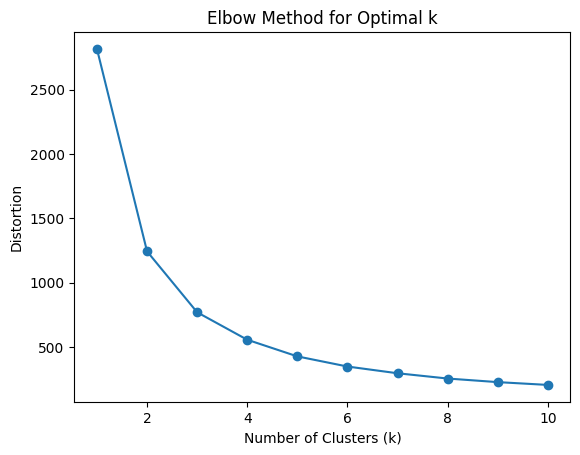

In [13]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

distortions = []


for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(vectors_2d)
    distortions.append(kmeans.inertia_)

plt.plot(range(1, 11), distortions, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Distortion')
plt.show()

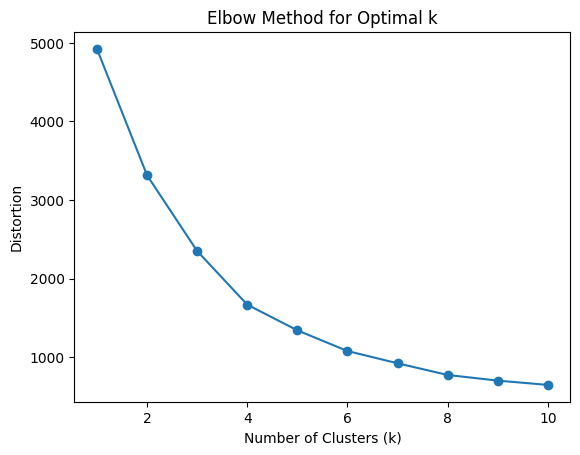

In [14]:
distortions = []


for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(vectors_3d)
    distortions.append(kmeans.inertia_)

plt.plot(range(1, 11), distortions, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Distortion')
plt.show()

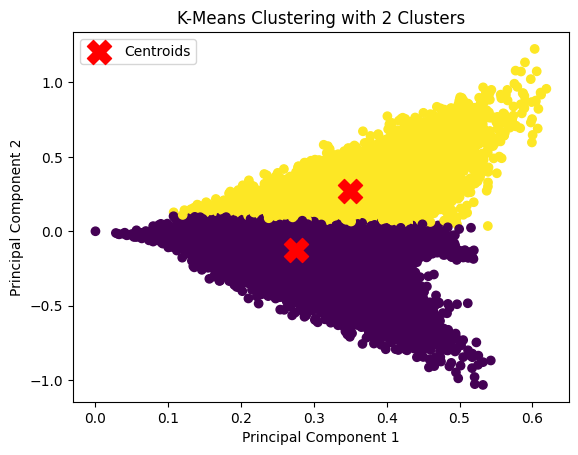

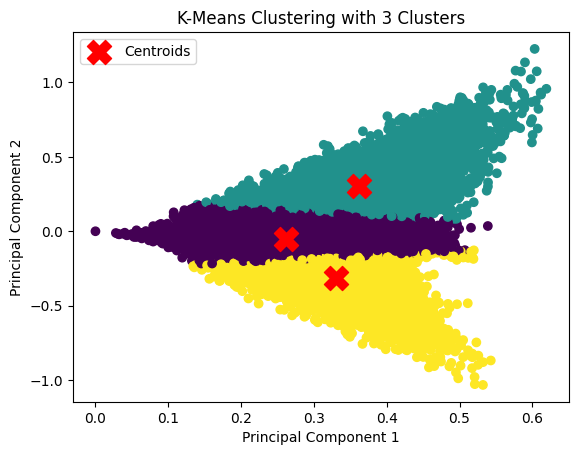

In [16]:
n_clusters_list = [2, 3]

for n_clusters in n_clusters_list:
    kmeans = KMeans(n_clusters=n_clusters, n_init=10, random_state=42)
    labels = kmeans.fit_predict(vectors_2d)

 
    plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1], c=labels, cmap='viridis')
    plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red', marker='X', label='Centroids')
    plt.title(f'K-Means Clustering with {n_clusters} Clusters')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.legend()
    plt.show()

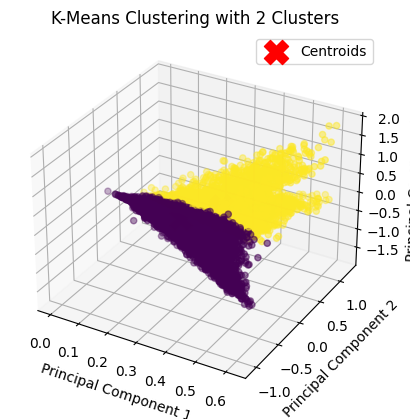

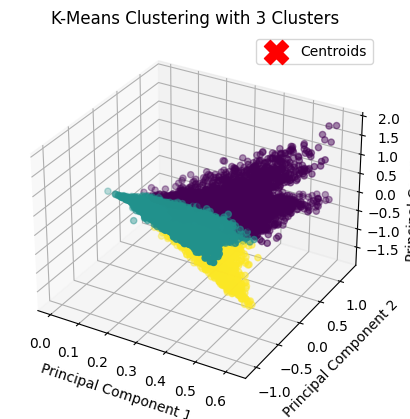

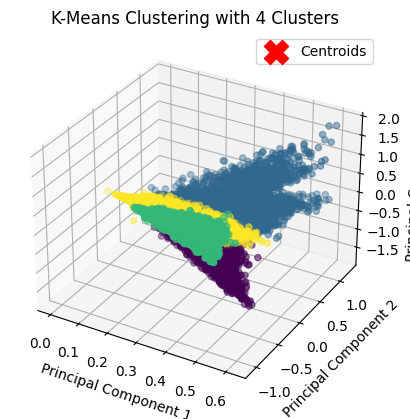

In [19]:
from mpl_toolkits.mplot3d import Axes3D 

n_clusters_list = [2,3, 4]

for n_clusters in n_clusters_list:
    kmeans = KMeans(n_clusters=n_clusters, n_init=10, random_state=42)
    labels = kmeans.fit_predict(vectors_3d)

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d') 

   
    ax.scatter(vectors_3d[:, 0], vectors_3d[:, 1], vectors_3d[:, 2], c=labels, cmap='viridis')
    ax.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2],
               s=300, c='red', marker='X', label='Centroids')

    ax.set_title(f'K-Means Clustering with {n_clusters} Clusters')
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.set_zlabel('Principal Component 3') 
    ax.legend()

    plt.show()


c:\Users\Abdelahi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


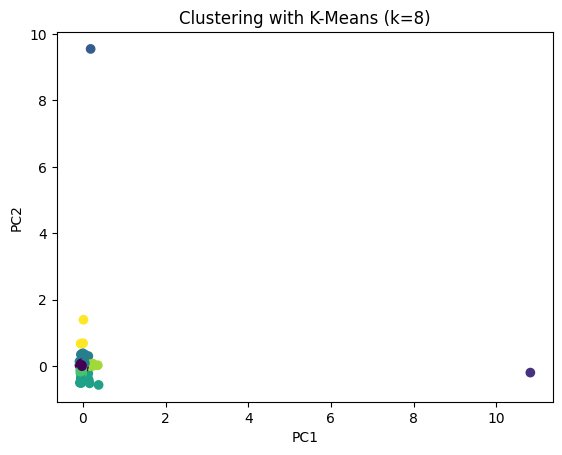

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

pca = PCA(n_components=2)
vectors_2d = pca.fit_transform(vectors)

k = 8
kmeans = KMeans(n_clusters=k)
kmeans.fit(vectors_2d)
labels = kmeans.labels_

plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1], c=labels, cmap='viridis')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title(f'Clustering with K-Means (k={k})')

plt.show()

c:\Users\Abdelahi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


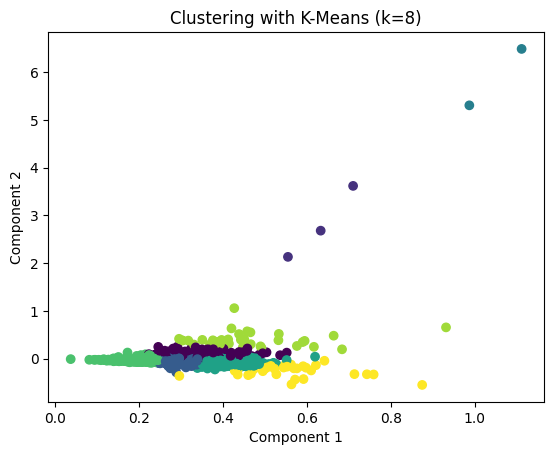

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import TruncatedSVD
from sklearn.cluster import KMeans

svd = TruncatedSVD(n_components=2)
vectors_2d = svd.fit_transform(vectors)

k = 8
kmeans = KMeans(n_clusters=k)
kmeans.fit(vectors_2d)
labels = kmeans.labels_

plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1], c=labels, cmap='viridis')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title(f'Clustering with K-Means (k={k})')

plt.show()

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# PCA برای تبدیل به فضای دوبعدی
pca = PCA(n_components=2)
vectors_2d = pca.fit_transform(vectors)

# محاسبه IQR و حذف داده‌های پرت
q1 = np.percentile(vectors, 25, axis=0)
q3 = np.percentile(vectors, 75, axis=0)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
mask = np.all((vectors >= lower_bound) & (vectors <= upper_bound), axis=1)
clean_vectors = vectors[mask, :]

# بررسی تعداد داده‌ها پس از حذف داده‌های پرت
if clean_vectors.shape[0] > 0.1 * vectors.shape[0]:
    # تنظیمات خوشه‌بندی K-Means
    k = 8
    kmeans = KMeans(n_clusters=k)
    
    # اجرای خوشه‌بندی
    kmeans.fit(clean_vectors)
    labels = kmeans.labels_
    
    # نمایش نتایج خوشه‌بندی
    plt.scatter(clean_vectors[:, 0], clean_vectors[:, 1], c=labels, cmap='viridis')
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.title(f'Clustering with K-Means (k={k})')
    plt.show()
else:
    raise ValueError("Too few remaining vectors after outlier removal.")

ValueError: Too few remaining vectors after outlier removal.

c:\Users\Abdelahi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\Abdelahi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\Abdelahi\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\Abdelahi\AppData\Local\Programs\Python\Python311\Lib\site-packages\

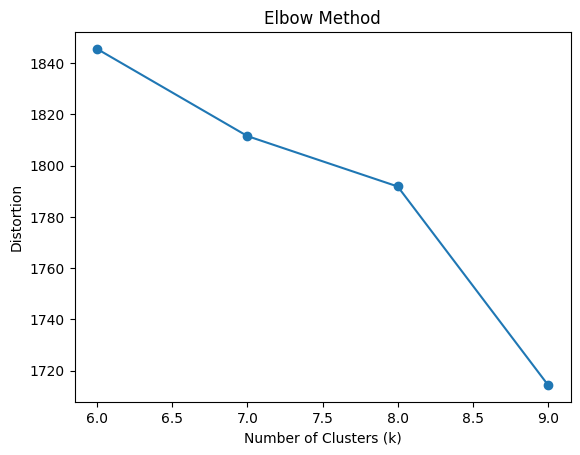

In [17]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

k_values = range(6, 10)
distortions = []

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(vectors)
    distortions.append(kmeans.inertia_)

plt.plot(k_values, distortions, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Distortion')
plt.title('Elbow Method')
plt.show()